In [1]:
from _eth_datas import DataProcessing
from _eth_process import EthernetProcess
from _eth_models import ModelsTraining
from _eth_model_evaluation import ModelEvaluation
from _eth_libs import *

/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/ethernet-env/lib/python3.12/site-packages/pydub/utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)
2024-07-03 16:12:37.459114: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:479] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-03 16:12:37.492533: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:10575] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-03 16:12:37.492576: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1442] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-07-03 16:12:37.513974: I tensorflow/core/platform/cpu_feature_gu

In [2]:
eth = EthernetProcess()
dtx = DataProcessing()
md  = ModelsTraining()
ev  = ModelEvaluation()


In [3]:
PATH = '/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/'

# path for datas
path = PATH + 'src/Dataset_labeled'


datas, data_numeric, target = dtx.dataset_transform(path, selected_features=['chanel0', 'chanel1', 'time_diff'])


In [8]:
data_numeric

,Chanel0_0,Chanel0_1,Chanel0_2,Chanel0_3,Chanel0_4,Chanel0_5,Chanel0_6,Chanel0_7,Chanel0_8,Chanel0_9,...,Chanel1_3,Chanel1_4,Chanel1_5,Chanel1_6,Chanel1_7,Chanel1_8,Chanel1_9,Chanel1_10,Chanel1_11,Time_Diff
0,245,246,247,161,249,78,250,250,252,167,...,182,185,78,201,255,219,134,237,159,0.000000
1,0,0,1,172,3,89,5,6,6,178,...,97,36,122,54,1,70,178,86,74,0.000125
2,10,10,11,182,13,97,15,11,16,180,...,66,124,58,127,255,127,255,127,255,0.000125
3,20,5,21,173,23,83,24,248,26,156,...,255,127,255,127,255,127,255,127,255,0.000125
4,29,225,31,129,33,32,34,190,36,90,...,108,97,32,83,185,69,123,54,169,0.000125
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1884056,127,153,127,184,127,210,127,229,127,243,...,255,127,255,127,255,127,255,127,255,0.000007
1884057,127,255,127,252,127,243,127,229,127,210,...,71,94,211,78,234,63,210,49,205,0.000007
1884058,109,34,110,0,110,217,111,173,112,124,...,116,0,0,249,109,244,218,242,96,0.000007
1884059,126,107,126,37,125,218,125,137,125,50,...,64,2,55,7,72,14,89,23,75,0.000070


In [9]:
dtx.plot_class_distribution(datas)

## **Algorithm training**

In [10]:
datas, predictors, data_numeric, target= dtx.encode_dataframe(path, classify_to_binary=True)


In [11]:
x_train, x_test, y_train, y_test = train_test_split(predictors, target, test_size = 0.3, random_state = 0)

In [11]:
md.random_forest_train(x_train, x_test, y_train, y_test)

              precision    recall  f1-score   support

           0       0.91      1.00      0.95    512851
           1       0.98      0.05      0.10     52368

    accuracy                           0.91    565219
   macro avg       0.95      0.53      0.53    565219
weighted avg       0.92      0.91      0.87    565219



In [9]:
md.naive_byes_train(x_train, x_test, y_train, y_test)

              precision    recall  f1-score   support

           0       0.91      0.98      0.94    512851
           1       0.24      0.08      0.12     52368

    accuracy                           0.89    565219
   macro avg       0.58      0.53      0.53    565219
weighted avg       0.85      0.89      0.87    565219



In [10]:
md.gradient_boost_train(x_train, x_test, y_train, y_test)

              precision    recall  f1-score   support

           0       0.91      1.00      0.95    512851
           1       0.98      0.05      0.10     52368

    accuracy                           0.91    565219
   macro avg       0.95      0.53      0.53    565219
weighted avg       0.92      0.91      0.87    565219



In [13]:
md.mlp_train(x_train, y_train, mult_label=False)


/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/ethernet-env/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.

2024-07-03 15:09:34.281722: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-07-03 15:09:34.869241: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2251] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platfor

Epoch 1/100
32972/32972 ━━━━━━━━━━━━━━━━━━━━ 81s 2ms/step - accuracy: 0.8993 - loss: 0.4121 - val_accuracy: 0.9129 - val_loss: 0.2974
Epoch 2/100
32972/32972 ━━━━━━━━━━━━━━━━━━━━ 86s 3ms/step - accuracy: 0.9125 - loss: 0.2975 - val_accuracy: 0.9130 - val_loss: 0.2949
Epoch 3/100
32972/32972 ━━━━━━━━━━━━━━━━━━━━ 86s 3ms/step - accuracy: 0.9124 - loss: 0.2969 - val_accuracy: 0.9130 - val_loss: 0.2955
Epoch 4/100
32972/32972 ━━━━━━━━━━━━━━━━━━━━ 83s 3ms/step - accuracy: 0.9122 - loss: 0.2972 - val_accuracy: 0.9130 - val_loss: 0.2954
Epoch 5/100
32972/32972 ━━━━━━━━━━━━━━━━━━━━ 79s 2ms/step - accuracy: 0.9119 - loss: 0.2981 - val_accuracy: 0.9130 - val_loss: 0.2954
Epoch 6/100
32972/32972 ━━━━━━━━━━━━━━━━━━━━ 84s 3ms/step - accuracy: 0.9124 - loss: 0.2970 - val_accuracy: 0.9130 - val_loss: 0.2956
Epoch 7/100
32972/32972 ━━━━━━━━━━━━━━━━━━━━ 84s 3ms/step - accuracy: 0.9126 - loss: 0.2965 - val_accuracy: 0.9130 - val_loss: 0.2954
Epoch 8/100
32972/32972 ━━━━━━━━━━━━━━━━━━━━ 84s 3ms/step - ac

## **Load weights trained**

In [ ]:
naive_path = PATH + 'src/trained_models/naive_model.pkl'
mlp_path = PATH + 'src/trained_models/mlp_model.weights.h5'
random_path = PATH + 'src/trained_models/forest_model.pkl'
boosting_path = PATH + 'src/trained_models/boost_model.pkl'


imput_dim = x_test.shape[1]
# Carregar modelos treinados
naive = ev.load_trained_model(naive_path, imput_dim)
mlp = ev.load_trained_model(mlp_path, imput_dim, model_name='mlp')
random = ev.load_trained_model(random_path, imput_dim)
boosting = ev.load_trained_model(boosting_path, imput_dim)


#### **MPL**

17664/17664 ━━━━━━━━━━━━━━━━━━━━ 22s 1ms/step - accuracy: 0.9127 - loss: 0.2957
17664/17664 ━━━━━━━━━━━━━━━━━━━━ 23s 1ms/step


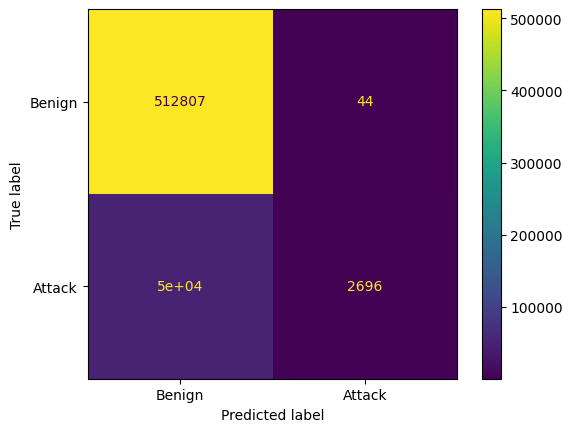

In [23]:
# MLP model
loss, accuracy = model.evaluate(x_test, y_test)
# Plot Confuse Mattrix
ev.plot_confusion_matrix(mlp, x_test, y_test)

#### **NAIVE BYES**

*****************************************************
Acurácia no conjunto de treino: 0.892859038459497
*****************************************************

*****************************************************
Acurácia no conjunto de teste: 0.8922576912665711
*****************************************************

Relatório de classificação - Conjunto de Treino:
*****************************************************
-----------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.98      0.94   1197262
           1       0.24      0.08      0.12    121580

    accuracy                           0.89   1318842
   macro avg       0.58      0.53      0.53   1318842
weighted avg       0.85      0.89      0.87   1318842


-----------------------------------------------------
*****************************************************
Relatório de classificação - Conjunto de Teste:
              precision    recall  f1-sco

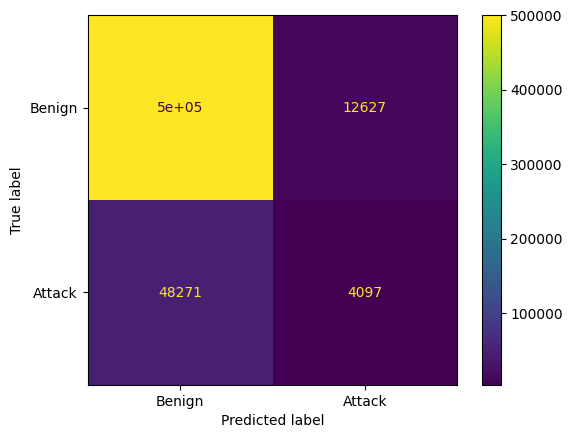

In [13]:
ev.evaluate_overfitting_and_plot_roc(naive_path ,x_train, y_train, x_test, y_test)

### **RANDON FORESTE**

*****************************************************
Acurácia no conjunto de treino: 0.9124239294775265
*****************************************************

*****************************************************
Acurácia no conjunto de teste: 0.9120411734212757
*****************************************************

Relatório de classificação - Conjunto de Treino:
*****************************************************
-----------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      1.00      0.95   1197262
           1       1.00      0.05      0.10    121580

    accuracy                           0.91   1318842
   macro avg       0.96      0.53      0.52   1318842
weighted avg       0.92      0.91      0.87   1318842


-----------------------------------------------------
*****************************************************
Relatório de classificação - Conjunto de Teste:
              precision    recall  f1-sc

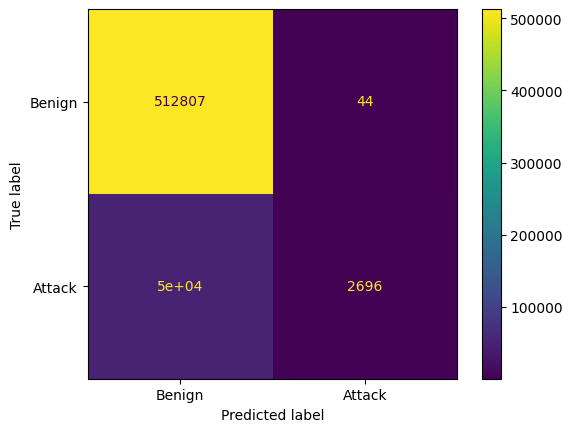

In [16]:
ev.evaluate_overfitting_and_plot_roc(random_path ,x_train, y_train, x_test, y_test)


### **GRADIENT BOOSTING**

*****************************************************
Acurácia no conjunto de treino: 0.9123518965880674
*****************************************************

*****************************************************
Acurácia no conjunto de teste: 0.9120411734212757
*****************************************************

Relatório de classificação - Conjunto de Treino:
*****************************************************
-----------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      1.00      0.95   1197262
           1       0.98      0.05      0.10    121580

    accuracy                           0.91   1318842
   macro avg       0.95      0.52      0.52   1318842
weighted avg       0.92      0.91      0.87   1318842


-----------------------------------------------------
*****************************************************
Relatório de classificação - Conjunto de Teste:
              precision    recall  f1-sc

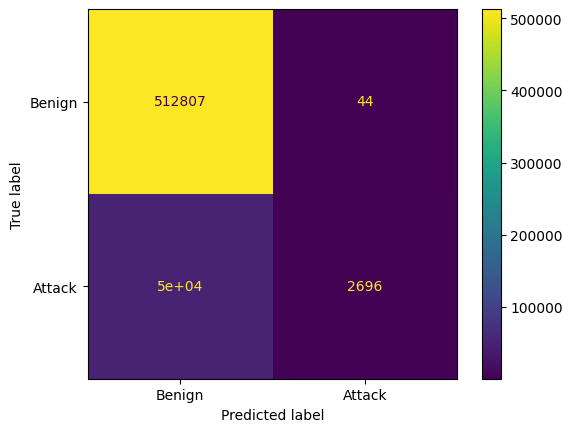

In [26]:
ev.evaluate_overfitting_and_plot_roc(boosting_path ,x_train, y_train, x_test, y_test)
